<a href="https://colab.research.google.com/github/Utpal-Mishra/Python-Final-Project-2020-21/blob/main/AirPollution2020.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#IMPORTING

###LIBRARIES

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import plotly.express as px
from datetime import datetime as dt

###IMPORT DRIVE

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


###IMPORT FILE

In [3]:
import pandas as pd
path = '/content/drive/My Drive/Final Project/waqi-covid19-airqualitydata-2020.csv'
data = pd.read_csv(path)
print("Data Shape: ", data.shape)
data.head()

Data Shape:  (823001, 9)


,Date,Country,City,Specie,count,min,max,median,variance
0,2020-01-16,MN,Ulan Bator,so2,157.0,5.1,76.0,18.1,3716.75
1,2020-03-06,MN,Ulan Bator,so2,206.0,1.1,41.6,13.6,892.86
2,2020-03-14,MN,Ulan Bator,so2,228.0,1.1,41.6,13.1,741.26
3,2020-05-03,MN,Ulan Bator,so2,153.0,0.6,30.8,2.6,210.96
4,2020-02-28,MN,Ulan Bator,so2,209.0,0.9,50.4,10.2,843.79


# DATA PREPROCESSING

## Cleaning Data

In [4]:
data = data[data.City.apply(lambda x: x.isalpha())]
data = data[data.Specie.apply(lambda x: x.isnumeric()==False)]
data = data[data.Specie.apply(lambda x: x == "pm25" or x == "pm10" or x == "no2" or x == "o3" or x == "so2" or x == "co" or x == "pm1")] 
data.sort_values(['Date', 'City', 'Specie'], inplace = True)
data.head()

,Date,Country,City,Specie,count,min,max,median,variance
682572,2019-12-30,SA,Abha,co,2.0,5.0,8.0,5.0,45.0
681515,2019-12-30,SA,Abha,no2,2.0,1.0,5.0,1.0,80.0
682138,2019-12-30,SA,Abha,o3,2.0,34.0,54.0,34.0,2000.0
682611,2019-12-30,SA,Abha,pm10,2.0,3.0,9.0,3.0,180.0
682278,2019-12-30,SA,Abha,so2,2.0,2.0,4.0,2.0,20.0


In [5]:
data.to_csv('COVID_2020.csv')
!cp COVID_2020.csv "/content/drive/My Drive/"

## Adding Class wrt Pollutant Species

In [6]:
SpecieClass = []
for i in data.Specie:
  if i=="co":
    SpecieClass.append(1)
  if i=="no2":
    SpecieClass.append(2)
  if i=="o3":
    SpecieClass.append(3)
  if i=="pm1":
    SpecieClass.append(4)
  if i=="pm10":
    SpecieClass.append(5)
  if i=="pm25":
    SpecieClass.append(6)
  if i=="so2":
    SpecieClass.append(7)

data["Class"] = SpecieClass


In [7]:
data.head()

,Date,Country,City,Specie,count,min,max,median,variance,Class
682572,2019-12-30,SA,Abha,co,2.0,5.0,8.0,5.0,45.0,1
681515,2019-12-30,SA,Abha,no2,2.0,1.0,5.0,1.0,80.0,2
682138,2019-12-30,SA,Abha,o3,2.0,34.0,54.0,34.0,2000.0,3
682611,2019-12-30,SA,Abha,pm10,2.0,3.0,9.0,3.0,180.0,5
682278,2019-12-30,SA,Abha,so2,2.0,2.0,4.0,2.0,20.0,7


#USING SEABORN

In [11]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import sys

In [12]:
sys.setrecursionlimit(100000)

In [13]:
#sns.set(style="ticks", color_codes=True)    
#g = sns.pairplot(data)
#plt.show()

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.



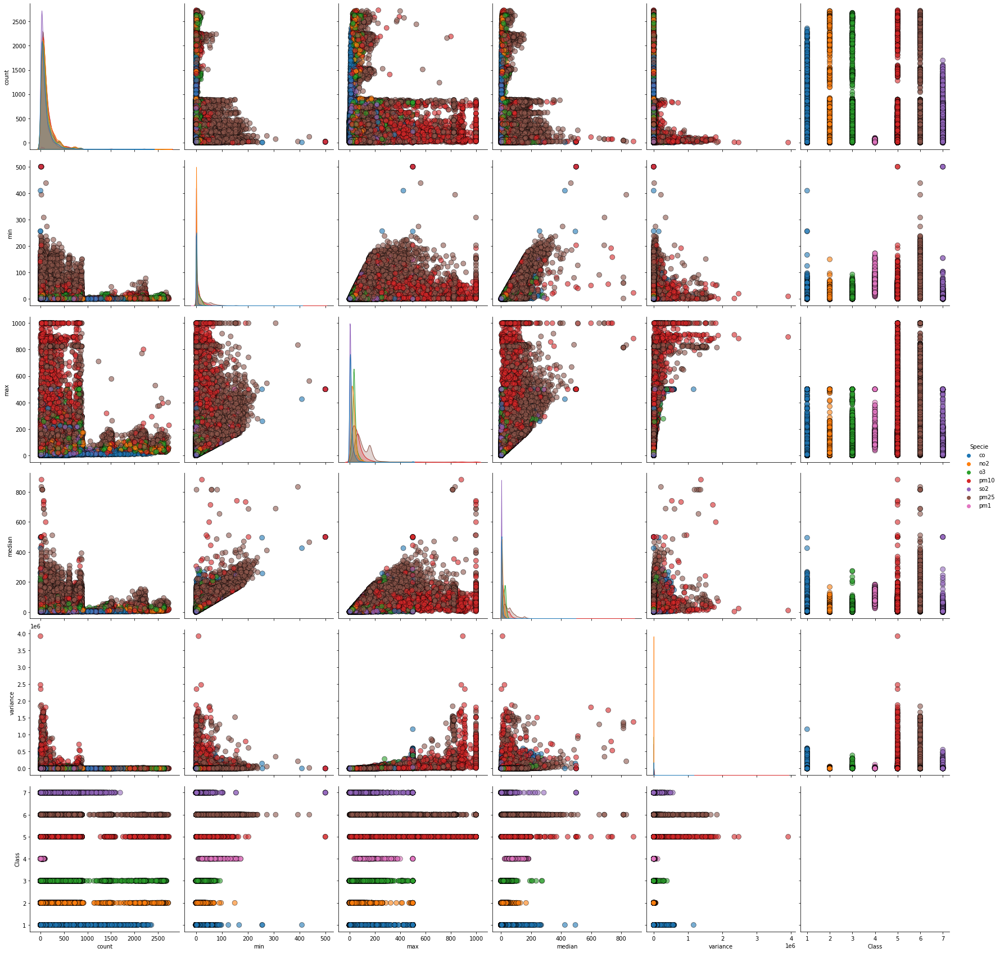

In [14]:
sns.pairplot(data, hue = 'Specie', plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'}, height = 4)

# PLOTLY

In [21]:
!pip install --upgrade plotly

Requirement already up-to-date: plotly in /usr/local/lib/python3.6/dist-packages (4.14.1)


In [22]:
#fig = px.parallel_coordinates(data, color = "Class", labels = {"Specie":"Species"},
#                    color_continuous_scale=px.colors.diverging.Tealrose, color_continuous_midpoint=2)
#fig.show()

## Scatter Plot

In [23]:
dt = data
dt["Size"] = 100*dt["count"]
dt.head()

,Date,Country,City,Specie,count,min,max,median,variance,Class,Size
682572,2019-12-30,SA,Abha,co,2.0,5.0,8.0,5.0,45.0,1,200.0
681515,2019-12-30,SA,Abha,no2,2.0,1.0,5.0,1.0,80.0,2,200.0
682138,2019-12-30,SA,Abha,o3,2.0,34.0,54.0,34.0,2000.0,3,200.0
682611,2019-12-30,SA,Abha,pm10,2.0,3.0,9.0,3.0,180.0,5,200.0
682278,2019-12-30,SA,Abha,so2,2.0,2.0,4.0,2.0,20.0,7,200.0


In [24]:
fig = px.scatter(dt, x="count", y="variance", animation_frame="Date", animation_group="Specie",
           size="Size", color="Specie", hover_name="Specie", facet_col="Specie",
           log_x=False, range_x=[-100,500], range_y=[-500,5000])
fig.show()

## Bar Plot

In [19]:
fig = px.bar(data, x='Specie', y = "count", animation_frame = "Date", color = "Specie")
fig.show()

## Area Plot

In [20]:
fig = px.area(data, x='Specie', y = "count", animation_frame = "Date", color = "Specie", line_group = "Date")
#fig.update_layout(
#    margin=dict(l=20, r=20, t=20, b=20)#,paper_bgcolor="LightSteelBlue",
#)
fig.show()

## Dynamic Bar Plot

In [14]:
import plotly.graph_objects as go

dt = data.sort_values(["Date"])
dt.head()

fig = go.Figure(go.Bar(
    x = dt['Date'],
    y = dt['count']))

fig.update_xaxes(
    rangeslider_visible=True,
    tickformatstops = [
        dict(dtickrange=[None, 100], value="%H:%M:%S.%L ms"),
        #dict(dtickrange=[1000, 60000], value="%H:%M:%S s"),
        #dict(dtickrange=[60000, 3600000], value="%H:%M m"),
        #dict(dtickrange=[3600000, 86400000], value="%H:%M h"),
        #dict(dtickrange=[86400000, 604800000], value="%e. %b d"),
        #dict(dtickrange=[604800000, "M1"], value="%e. %b w"),
        dict(dtickrange=["M1", "M12"], value="%b '%y M"),
        dict(dtickrange=["M12", None], value="%Y Y")
    ]
)

fig.show()

## PieChart

In [15]:
fig = px.sunburst(data, path=['Country', 'City'], values='count', color='Country', hover_data=['count'])
fig.show()

# Time Series Analysis

In [11]:
from matplotlib import pyplot
from pandas.plotting import lag_plot

In [12]:
dt = pd.DataFrame(data[["Date", "count"]].groupby("Date").sum())
dt.head()

,count
Date,
2019-12-30,262870.0
2019-12-31,264502.0
2020-01-01,270701.0
2020-01-02,291929.0
2020-01-03,302196.0


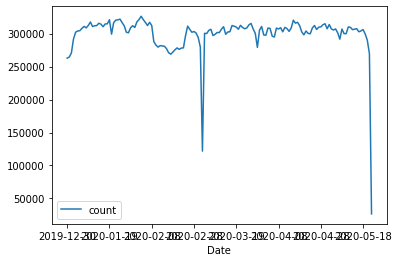

In [13]:
dt.plot()

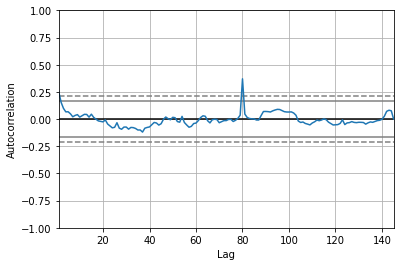

In [14]:
from pandas.plotting import autocorrelation_plot

autocorrelation_plot(dt)
pyplot.show()

In [15]:
!pip install statsmodels

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



                             ARIMA Model Results                              
Dep. Variable:                D.count   No. Observations:                  144
Model:                 ARIMA(5, 1, 0)   Log Likelihood               -1680.123
Method:                       css-mle   S.D. of innovations          28217.990
Date:                Tue, 15 Dec 2020   AIC                           3374.246
Time:                        18:01:56   BIC                           3395.035
Sample:                    12-31-2019   HQIC                          3382.693
                         - 05-22-2020                                         
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const          -828.6677   1237.130     -0.670      0.504   -3253.398    1596.062
ar.L1.D.count    -0.4160      0.127     -3.277      0.001      -0.665      -0.167
ar.L2.D.count    -0.2214      0.145     

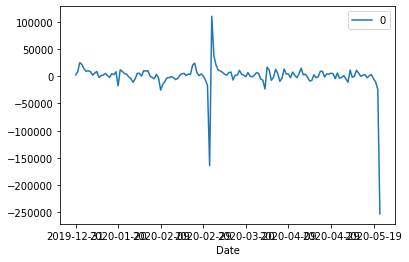

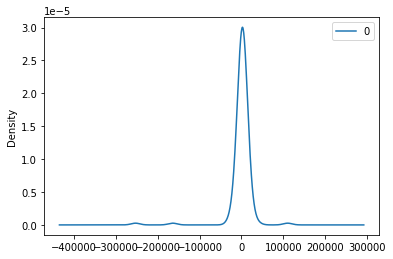

                   0
count     144.000000
mean       94.879957
std     28319.271222
min   -252841.027918
25%     -2564.865012
50%      2072.338290
75%      6671.411080
max    110264.453568


In [16]:
import statsmodels.api as sm
from matplotlib import pyplot
from pandas import datetime

def parser(x):
	return datetime.strptime('190'+x, '%Y-%m')
 
#series = read_csv('shampoo-sales.csv', header=0, index_col=0, parse_dates=True, squeeze=True, date_parser=parser)
#dt.index = dt.index.to_period('M')

model = sm.tsa.ARIMA(dt, order=(5,1,0))
model_fit = model.fit()

print(model_fit.summary())

residuals = pd.DataFrame(model_fit.resid)
residuals.plot()
pyplot.show()

residuals.plot(kind='kde')
pyplot.show()

print(residuals.describe())

predicted=298088.016473, expected=308487.000000
predicted=303710.493191, expected=307968.000000
predicted=307294.919781, expected=296220.000000
predicted=301973.769715, expected=294858.000000
predicted=298916.334330, expected=308414.000000
predicted=304544.379188, expected=307115.000000
predicted=306193.696407, expected=308964.000000
predicted=306489.889212, expected=302827.000000
predicted=304277.486207, expected=309567.000000
predicted=307692.849566, expected=307678.000000
predicted=308517.129791, expected=303441.000000
predicted=306649.839970, expected=308621.000000
predicted=307718.253325, expected=320386.000000
predicted=313586.568412, expected=315948.000000
predicted=314415.256222, expected=317226.000000
predicted=315152.430294, expected=312038.000000
predicted=314134.388814, expected=302584.000000
predicted=310674.791010, expected=298238.000000
predicted=306774.693335, expected=304059.000000
predicted=306758.292993, expected=300405.000000
predicted=304452.176707, expected=299795

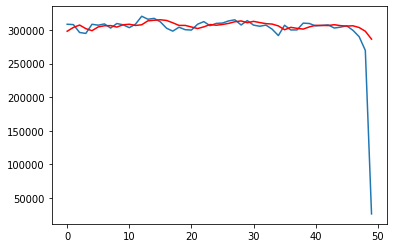

In [17]:
from sklearn.metrics import mean_squared_error
import numpy as np

X = dt.values
size = int(len(X) * 0.66)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]

predictions = list()

for t in range(len(test)):
	model = sm.tsa.ARIMA(history, order=(5,1,0))
	model_fit = model.fit()
	output = model_fit.forecast()
	yhat = output[0]
	predictions.append(yhat)
	obs = test[t]
	history.append(obs)
	print('predicted=%f, expected=%f' % (yhat, obs))


rmse = np.sqrt(mean_squared_error(test, predictions))
print('Test RMSE: %.3f' % rmse)


pyplot.plot(test)
pyplot.plot(predictions, color='red')
pyplot.show()